In [ ]:
import os


In [ ]:
!mkdir dataset
!mkdir dataset/clear
!mkdir dataset/dirty


mkdir: cannot create directory ‘data’: File exists
mkdir: cannot create directory ‘data/clear’: File exists
mkdir: cannot create directory ‘data/dirty’: File exists


In [ ]:
os.listdir("data")

['dirty', 'clear']

In [ ]:
import numpy as np
import cv2 as cv2
from matplotlib import pyplot as plt
from os import listdir
import base64
from PIL import Image
from io import BytesIO
import numpy as np
import imutils

In [ ]:
size1_final_image = 540
size2_final_image = 258

size1_input_image = 360
size2_input_image = 172

In [ ]:
import numpy as np
import os
import cv2
def noisy(noise_typ,image):
   if noise_typ == "gauss":
      row,col,ch= image.shape
      mean = 1
      var = 0.01
      sigma = var**0.5
      gauss = np.random.normal(mean,sigma,(row,col,ch))
      gauss = gauss.reshape(row,col,ch)
      noisy = image + gauss
      return noisy
   elif noise_typ == "s&p":
      row,col,ch = image.shape
      s_vs_p = 0.5
      amount = 0.004
      out = np.copy(image)
      # Salt mode
      num_salt = np.ceil(amount * image.size * s_vs_p)
      coords = [np.random.randint(0, i - 1, int(num_salt))
              for i in image.shape]
      out[coords] = 1

      # Pepper mode
      num_pepper = np.ceil(amount* image.size * (1. - s_vs_p))
      coords = [np.random.randint(0, i - 1, int(num_pepper))
              for i in image.shape]
      out[coords] = 0
      return out
   elif noise_typ == "poisson":
    vals = len(np.unique(image))
    vals = 2 ** np.ceil(np.log2(vals))
    noisy = np.random.poisson(image * vals) / float(vals)
    return noisy

   elif noise_typ =="speckle":
    row,col,ch = image.shape
    gauss = np.random.randn(row,col,ch)
    gauss = gauss.reshape(row,col,ch)        
    noisy = image + image * gauss
    return noisy

In [ ]:
def pre_processing(img):
  img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
  img = cv2.GaussianBlur(img,(3,3),1)
  img = cv2.Laplacian(img,cv2.CV_8U)
  img = np.invert(img)
  
  thresh = 230
  super_threshold_indices = img > thresh
  img[super_threshold_indices] =  254
  low_threshold_indices = img < thresh
  img[low_threshold_indices] =  0

  img = cv2.resize(img, (size1_input_image , size2_input_image), interpolation=cv2.INTER_CUBIC)
  return img

In [ ]:
def create_train_data():
    train_data = []
    shapes = []
    train_data_labels = []
    for path in listdir("data/dirty"):
      if path in listdir("data/clear"):
        img_c = cv2.imread('data/clear/' + path)
        
        x2 = pre_processing(noisy("gauss",img_c).astype("uint8") * 255)
        x3 = pre_processing(noisy("s&p",img_c).astype("uint8") * 255)
        x4 = pre_processing(noisy("poisson",img_c).astype("uint8") * 255)


        shapes.append((img_c.shape[1], img_c.shape[0]))
        
        img_c  = cv2.cvtColor(img_c, cv2.COLOR_BGR2GRAY)

        img_cf = cv2.flip(img_c, 0)
        
        img_c90  = cv2.rotate(img_c, cv2.cv2.ROTATE_90_CLOCKWISE)
        img_c90f = cv2.flip(img_c90, 0)

        img_c180  = cv2.rotate(img_c, cv2.ROTATE_180)
        img_c180f = cv2.flip(img_c180, 0)

        img_c270 = cv2.rotate(img_c, cv2.ROTATE_90_COUNTERCLOCKWISE)
        img_c270f = cv2.flip(img_c270, 0)

        img_c  = cv2.resize(img_c, (size1_final_image, size2_final_image), interpolation=cv2.INTER_CUBIC)
        img_cf  = cv2.resize(img_cf, (size1_final_image, size2_final_image), interpolation=cv2.INTER_CUBIC)
        img_c180  = cv2.resize(img_c180, (size1_final_image, size2_final_image), interpolation=cv2.INTER_CUBIC)
        img_c180f  = cv2.resize(img_c180f, (size1_final_image, size2_final_image), interpolation=cv2.INTER_CUBIC)
      

        y = img_c.flatten()
        yf = img_cf.flatten()
        

        y180 = img_c180.flatten()
        y180f = img_c180f.flatten()

    
        img = cv2.imread('data/dirty/' + path)
        x = pre_processing(img)
        xf = cv2.flip(x, 0)


        x180 = cv2.rotate(x, cv2.ROTATE_180)
        x180f = cv2.flip(x180, 0)


        train_data.append(x / 255)
        #print("flag1 ", x.shape)
        train_data_labels.append(y / 255)


        train_data.append(x180 / 255)
        #print("flag3 ", x180.shape)
        train_data_labels.append(y180 / 255)


        train_data.append(xf / 255)
        #print("flag5 ", xf.shape)
        train_data_labels.append(yf / 255)

        train_data.append(x180f / 255)
        #print("flag7 ", x180f.shape)
        train_data_labels.append(y180f / 255)

        train_data.append(x2/255)
        #print("flag9 ", x2.shape)
        train_data_labels.append(y/255)
        x2_f =  cv2.flip(x2, 0)
        x2_180 = cv2.rotate(x2, cv2.ROTATE_180)
        x2_180f = cv2.flip(x2_180, 0)

        train_data.append(x2_f/255)
        train_data_labels.append(yf/255)

        train_data.append(x2_180/255)
        train_data_labels.append(y180/255)

        train_data.append(x2_180f/255)
        train_data_labels.append(y180f/255)

        train_data.append(x3/255)
        #print("flag10 ", x3.shape)
        train_data_labels.append(y/255)
        x3_f =  cv2.flip(x3, 0)
        x3_180 = cv2.rotate(x3, cv2.ROTATE_180)
        x3_180f = cv2.flip(x3_180, 0)

        train_data.append(x3_f/255)
        train_data_labels.append(yf/255)

        train_data.append(x3_180/255)
        train_data_labels.append(y180/255)

        train_data.append(x3_180f/255)
        train_data_labels.append(y180f/255)

        train_data.append(x4/255)
        #print("flag11 ", x4.shape)
        train_data_labels.append(y/255)
        x4_f =  cv2.flip(x4, 0)
        x4_180 = cv2.rotate(x4, cv2.ROTATE_180)
        x4_180f = cv2.flip(x4_180, 0)

        train_data.append(x4_f/255)
        train_data_labels.append(yf/255)

        train_data.append(x4_180/255)
        train_data_labels.append(y180/255)

        train_data.append(x4_180f/255)
        train_data_labels.append(y180f/255)

      else:
        img = cv2.imread('data/dirty/' + path)
        img2 = img
        
        img = cv2.cvtColor(img, cv2.COLOR_BGR2GRAY)
        img = cv2.GaussianBlur(img,(3,3),1)
        img = cv2.Laplacian(img,cv2.CV_8U)
        img = np.invert(img)

        thresh = 230
        super_threshold_indices = img > thresh
        img[super_threshold_indices] =  254
        low_threshold_indices = img < thresh
        img[low_threshold_indices] =  0

        y = cv2.resize(img, (size1_final_image, size2_final_image), interpolation=cv2.INTER_CUBIC)

        yf =  cv2.flip(y, 0)
        y180 = cv2.rotate(y, cv2.ROTATE_180)
        y180f = cv2.flip(y180, 0)


        y = y.flatten()
        yf = yf.flatten()
        y180 = y180.flatten()
        y180f = y180f.flatten()
        
        x = pre_processing(img2)
        xf =  cv2.flip(x, 0)
        x180 = cv2.rotate(x, cv2.ROTATE_180)
        x180f = cv2.flip(x180, 0)

  
        train_data.append(x/255)
        train_data_labels.append(y/255)

        train_data.append(xf/255)
        train_data_labels.append(yf/255)

        train_data.append(x180/255)
        train_data_labels.append(y180/255)

        train_data.append(x180f/255)
        train_data_labels.append(y180f/255)

    return np.array(train_data) , np.array(train_data_labels), shapes

In [ ]:
import tensorflow as tf
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))


from tensorflow.keras import datasets, layers, models
import matplotlib.pyplot as plt

Num GPUs Available:  1


In [ ]:
from sklearn.model_selection import train_test_split

data, labels, shapes = create_train_data()

/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:23: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.
/usr/local/lib/python3.7/dist-packages/ipykernel_launcher.py:29: FutureWarning: Using a non-tuple sequence for multidimensional indexing is deprecated; use `arr[tuple(seq)]` instead of `arr[seq]`. In the future this will be interpreted as an array index, `arr[np.array(seq)]`, which will result either in an error or a different result.


In [ ]:
X_train, X_test, y_train, y_test = train_test_split(
    data, labels, test_size=0.30, random_state=42)

y_test1 = y_test[:]
X_test1 = X_test[:]

In [ ]:
print("X train len: ", len(X_train))
print("X test len: ", len(X_test))
#print(len(X_test[0]))

print("Y train len: ", len(y_train))
print("Y test len: ", len(y_test))

X train len:  1814
X test len:  778
Y train len:  1814
Y test len:  778


In [ ]:
X_train = X_train.reshape(-1, size2_input_image, size1_input_image, 1)

X_train = tf.convert_to_tensor(X_train)
y_train = tf.convert_to_tensor(y_train)

X_test = X_test.reshape(-1, size2_input_image, size1_input_image, 1)

X_test = tf.convert_to_tensor(X_test)
y_test = tf.convert_to_tensor(y_test)

In [ ]:
model = models.Sequential()
model.add(layers.Conv2D(20, (6, 6), activation='relu', input_shape=(size2_input_image, size1_input_image, 1)))
model.add(layers.MaxPooling2D((3, 3)))

model.add(layers.Conv2D(10, (3, 3), activation='relu', input_shape=(size2_input_image, size1_input_image, 1)))
model.add(layers.MaxPooling2D((3, 3)))

model.add(layers.Conv2D(10, (2, 2), activation='relu', input_shape=(size2_input_image, size1_input_image, 1)))
model.add(layers.MaxPooling2D((3, 3)))

model.add(layers.Flatten())
model.add(layers.Dense(1200, activation='relu'))
model.add(layers.Dense(size2_final_image * size1_final_image, activation='sigmoid'))

In [ ]:
model.summary()


Model: "sequential"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
conv2d (Conv2D)              (None, 167, 355, 20)      740       
_________________________________________________________________
max_pooling2d (MaxPooling2D) (None, 55, 118, 20)       0         
_________________________________________________________________
conv2d_1 (Conv2D)            (None, 53, 116, 10)       1810      
_________________________________________________________________
max_pooling2d_1 (MaxPooling2 (None, 17, 38, 10)        0         
_________________________________________________________________
conv2d_2 (Conv2D)            (None, 16, 37, 10)        410       
_________________________________________________________________
max_pooling2d_2 (MaxPooling2 (None, 5, 12, 10)         0         
_________________________________________________________________
flatten (Flatten)            (None, 600)               0

In [ ]:
callback = tf.keras.callbacks.EarlyStopping(monitor='val_loss', patience=10)

model.compile(optimizer='ADAM',
            loss=tf.keras.losses.BinaryCrossentropy(from_logits=False),
            metrics=['binary_crossentropy'])

history = model.fit(X_train, y_train, epochs=150, 
                    validation_data=(X_test, y_test),
                     callbacks=[callback])

Epoch 1/150
57/57 [==============================] - 21s 197ms/step - loss: 0.3843 - binary_crossentropy: 0.3843 - val_loss: 0.3356 - val_binary_crossentropy: 0.3356
Epoch 2/150
57/57 [==============================] - 9s 158ms/step - loss: 0.3354 - binary_crossentropy: 0.3354 - val_loss: 0.3357 - val_binary_crossentropy: 0.3357
Epoch 3/150
57/57 [==============================] - 9s 158ms/step - loss: 0.3350 - binary_crossentropy: 0.3350 - val_loss: 0.3354 - val_binary_crossentropy: 0.3354
Epoch 4/150
57/57 [==============================] - 9s 157ms/step - loss: 0.3351 - binary_crossentropy: 0.3351 - val_loss: 0.3354 - val_binary_crossentropy: 0.3354
Epoch 5/150
57/57 [==============================] - 9s 160ms/step - loss: 0.3349 - binary_crossentropy: 0.3349 - val_loss: 0.3342 - val_binary_crossentropy: 0.3342
Epoch 6/150
57/57 [==============================] - 9s 158ms/step - loss: 0.3331 - binary_crossentropy: 0.3331 - val_loss: 0.3297 - val_binary_crossentropy: 0.3297
Epoch 7/1

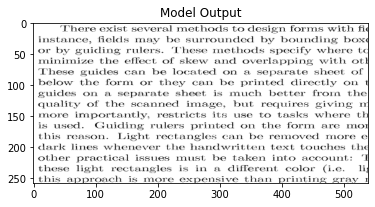

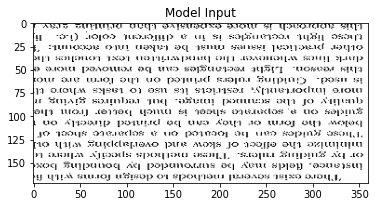

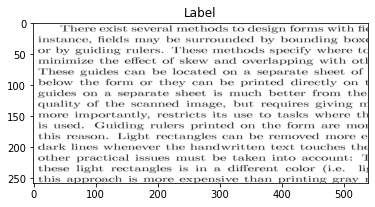

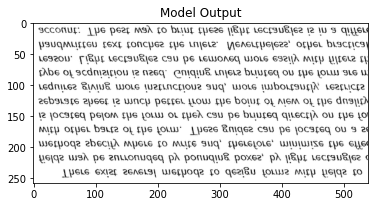

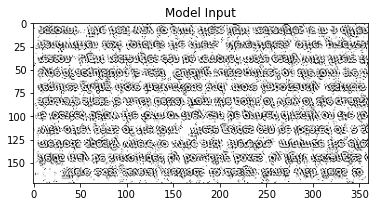

...

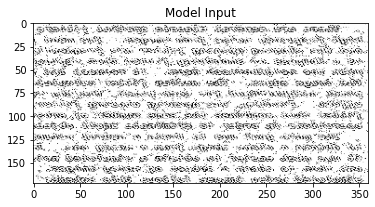

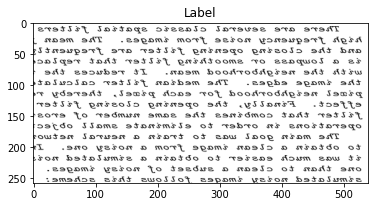

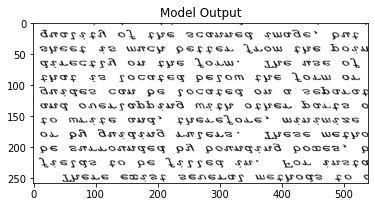

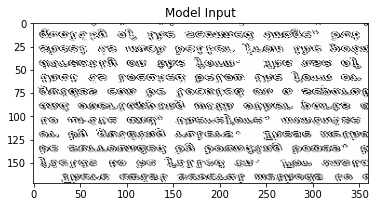

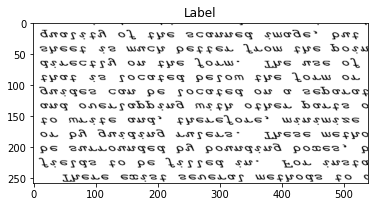

In [ ]:
response = model.predict(X_test)
i = 0
for i in range(len(response)):
  x = response[i]
  y = y_test1[i]
  z = X_test1[i]
  #img_c = cv2.resize(x, d, interpolation=cv2.INTER_CUBIC)
  plt.imshow(x.reshape(size2_final_image, size1_final_image), cmap="gray")
  plt.title("Model Output")
  plt.show()

  plt.imshow(z.reshape(size2_input_image, size1_input_image), cmap="gray")
  plt.title("Model Input")
  plt.show()

  plt.imshow(y.reshape(size2_final_image, size1_final_image), cmap='gray')
  plt.title("Label")
  plt.show()
  print("\n"*3)
